# Import packages and data 

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import scipy.stats
import anndata
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.axes._axes import _log as matplotlib_axes_logger
from scipy import sparse
matplotlib_axes_logger.setLevel('ERROR')
import warnings
warnings.filterwarnings('ignore')

/Users/b8058304/.pyenv/versions/3.6.4/envs/py36/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [3]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [4]:
sc.settings.verbosity = 1  # verbosity: errors (0), warnings (1), info (2), hints (3)
# Set up the plot config for viewing the annotation clearly.
sc.settings.set_figure_params(dpi=120, dpi_save=1000)
sc.logging.print_versions()

scanpy==1.4.4 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.2 scikit-learn==0.22.2.post1 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


# Load liver dataset

In [5]:
adata = sc.read('/Users/b8058304/Documents/PhD_work/Coding/ys/data/Liver_data_YS_paper_singlets_dr_20200429.h5ad')

In [6]:
adata.shape

(50856, 25756)

In [7]:
cell_numbers = adata.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
DC1                  217
DC2                 2186
Early Erythroid     1559
Endothelium         2408
Erythroid           9332
Fibroblast          3356
HSC/MPP             3332
Hepatocyte          8197
Kupffer            12830
MEMP                1768
Mast cell            465
Megakaryocyte       1439
Monocyte             912
NK cell              832
Neut_Myeloid         622
Pre B cell           231
Pre pro B cell       511
Pro B cell           461
pDC precursor        198
dtype: int64

# Cluster

In [8]:
sc.tl.leiden(adata, resolution=1.5, random_state=26, n_iterations=-1)

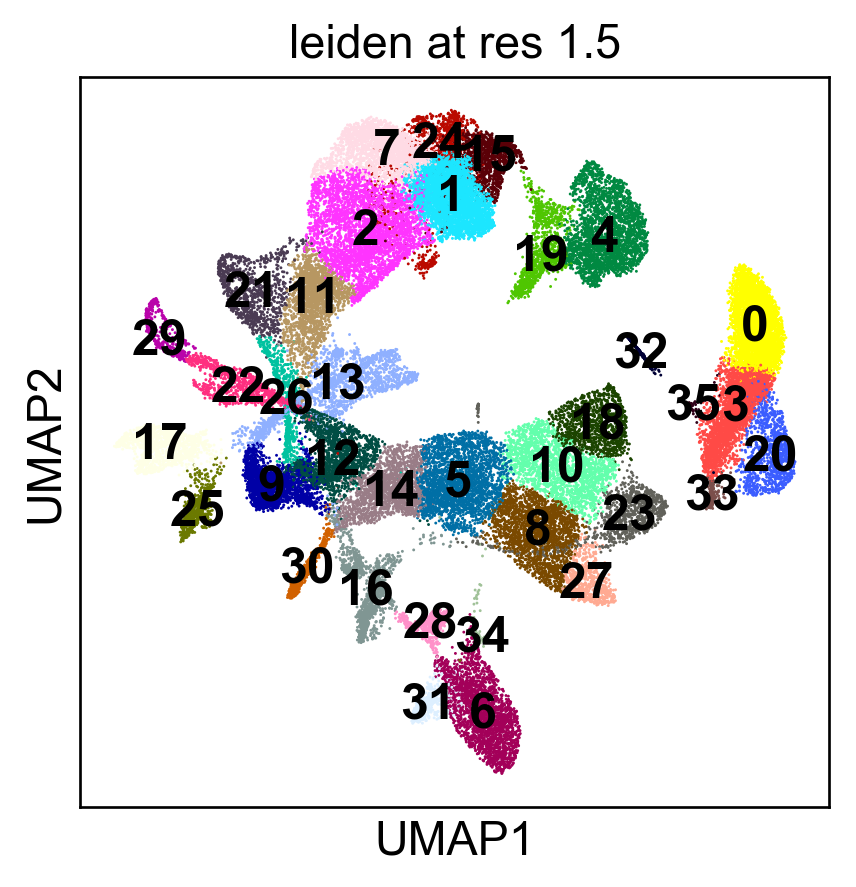

In [9]:
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=15, title="leiden at res 1.5")

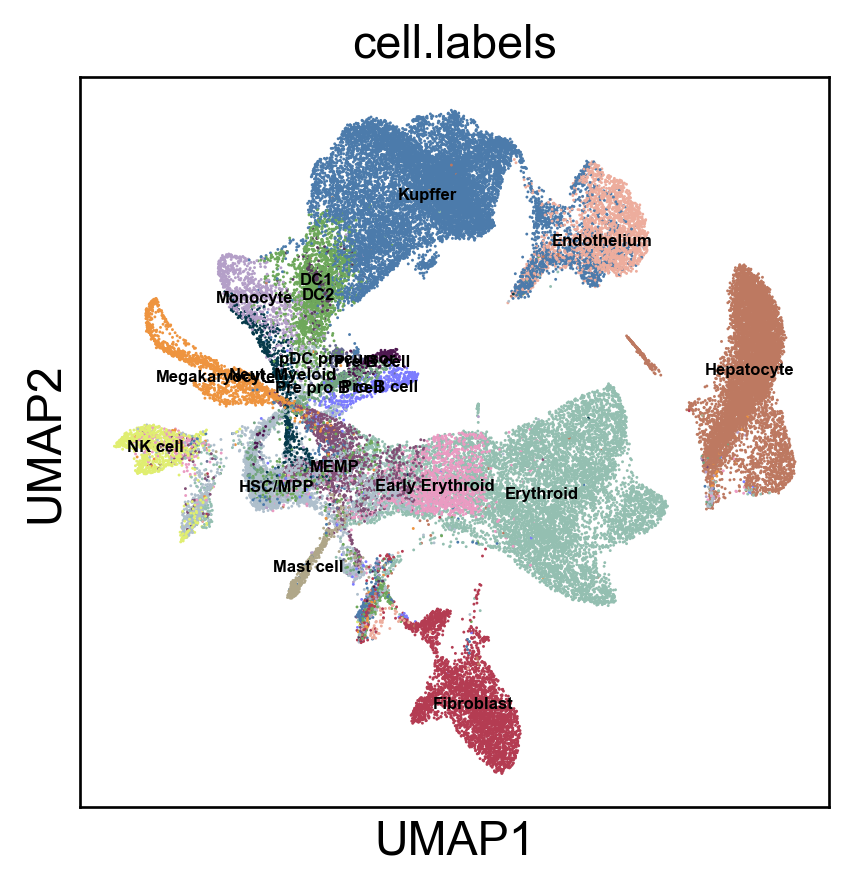

In [10]:
sc.pl.umap(adata, color='cell.labels', legend_loc="on data", size=3, legend_fontsize=5)

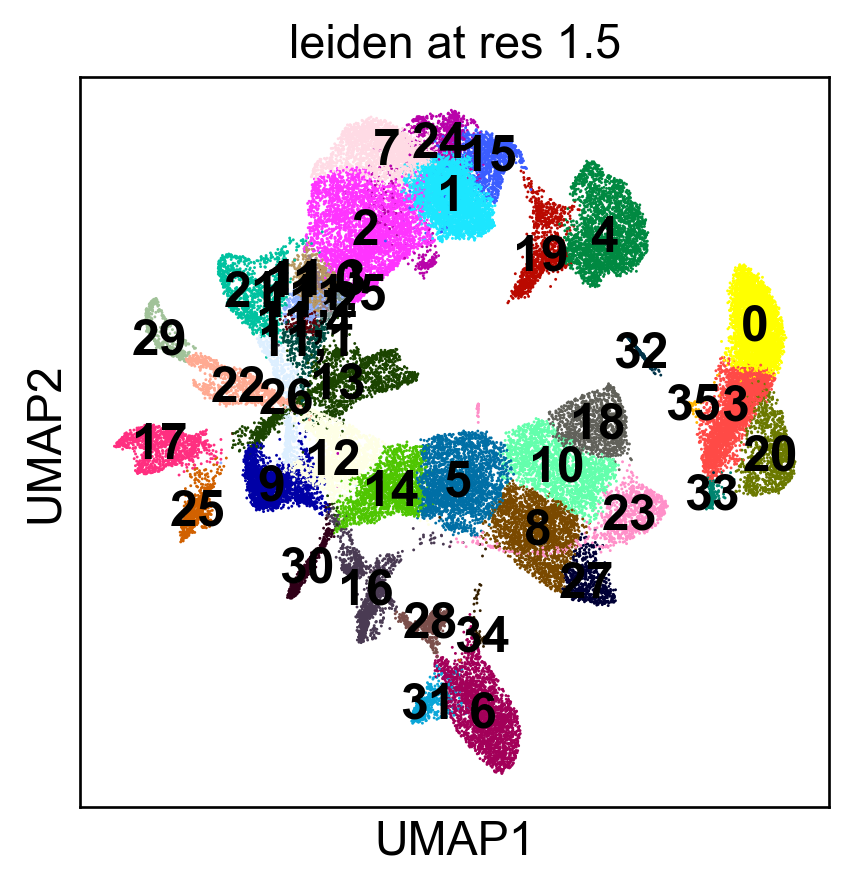

In [11]:
sc.tl.leiden(adata, resolution=0.5, random_state=26, n_iterations=-1, restrict_to=("leiden", ["11"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=15, title="leiden at res 1.5")

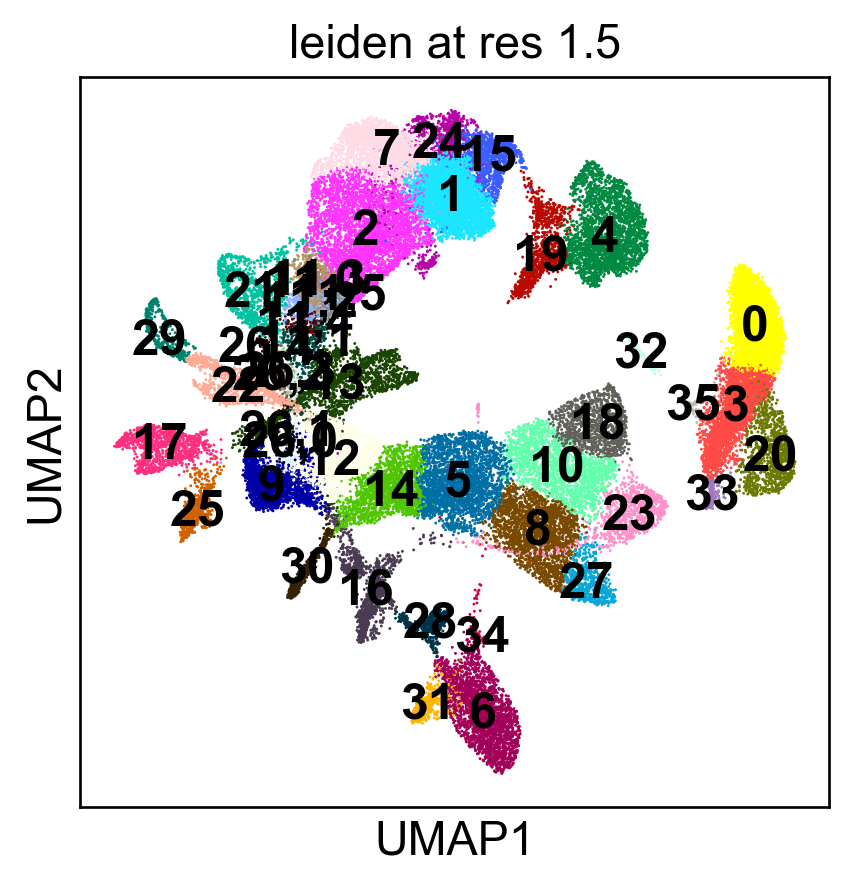

In [12]:
sc.tl.leiden(adata, resolution=0.5, random_state=26, n_iterations=-1, restrict_to=("leiden", ["26"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=15, title="leiden at res 1.5")

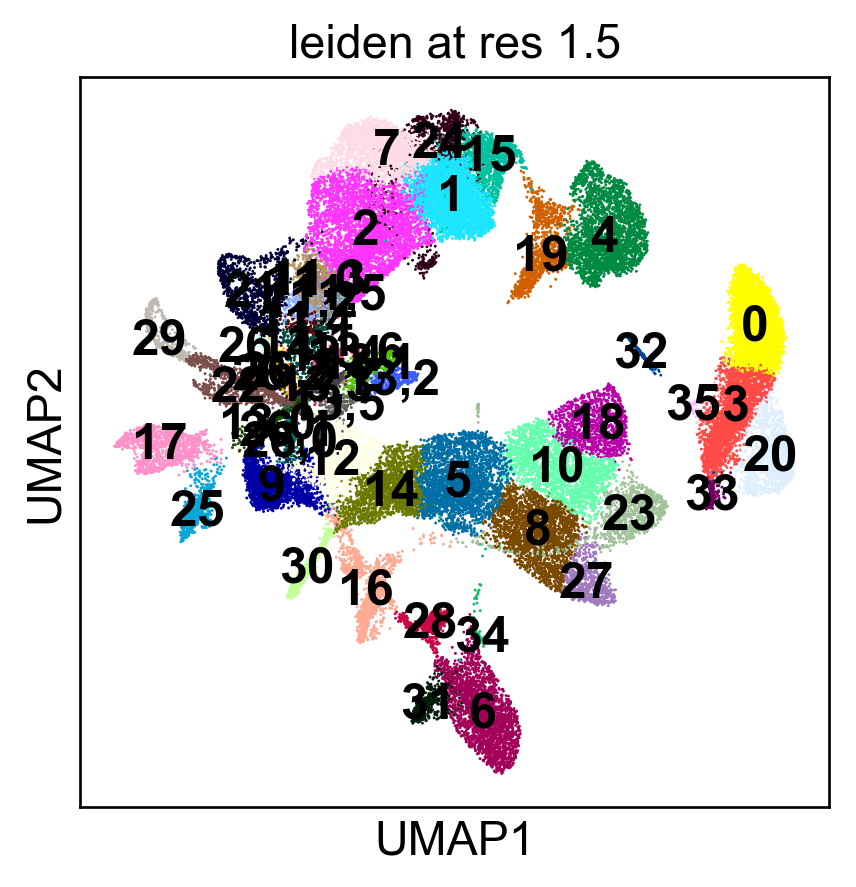

In [13]:
sc.tl.leiden(adata, resolution=0.5, random_state=26, n_iterations=-1, restrict_to=("leiden", ["13"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=15, title="leiden at res 1.5")

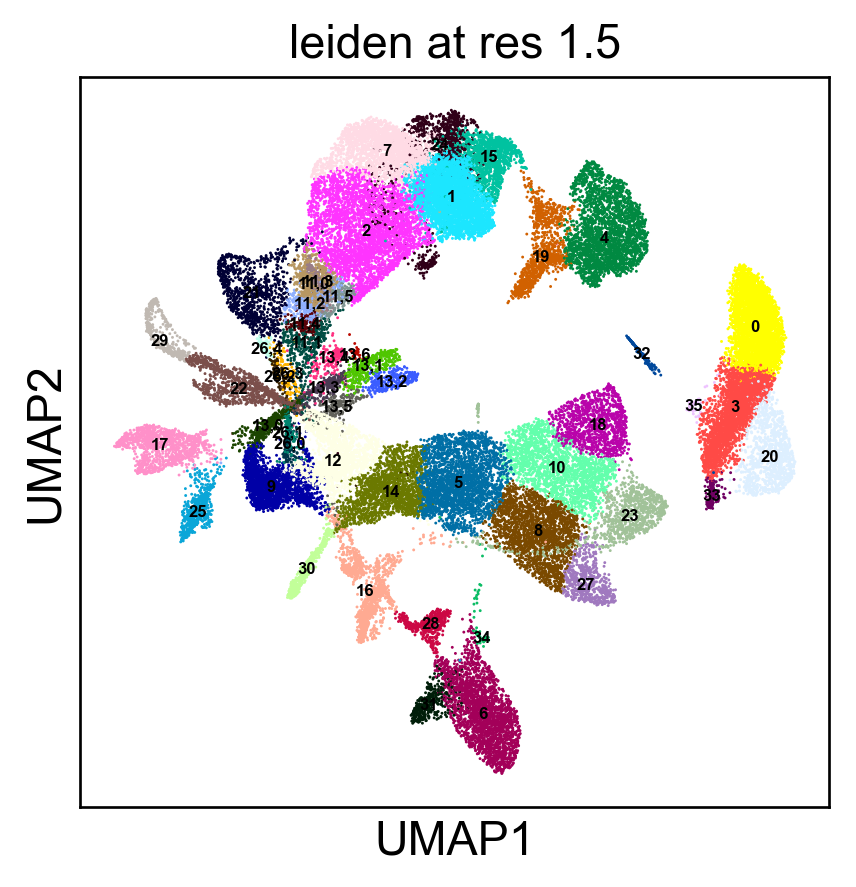

In [25]:
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=5, title="leiden at res 1.5")

In [15]:
cell_numbers = adata.obs.groupby(["leiden", "cell.labels"]).apply(len)
cell_numbers.to_csv("/Users/b8058304/Documents/PhD_work/Coding/ys/resources_for_pipelines/ys_liver_clus_celltypes_20200429.csv")
cell_numbers

leiden  cell.labels    
0       Hepatocyte         3893
        Monocyte              1
1       Erythroid             1
        Hepatocyte            2
        Kupffer            3766
        Megakaryocyte         3
2       DC1                  28
        DC2                 438
        Erythroid             2
        Kupffer            3057
        Megakaryocyte         3
        Monocyte              8
3       Early Erythroid       3
        Erythroid             1
        Hepatocyte         2832
        MEMP                  3
        Mast cell             2
        Megakaryocyte        14
        Monocyte              8
        Pre pro B cell        6
        Pro B cell            1
4       Endothelium        1959
        Kupffer             612
5       DC2                   1
        Early Erythroid     915
        Erythroid          1615
        Fibroblast            1
        HSC/MPP              10
        Hepatocyte            3
        Kupffer               2
        MEMP    

In [16]:
adata.obs.groupby(["leiden"]).apply(len)

leiden
0       3894
1       3772
2       3536
3       2870
4       2571
5       2569
6       2362
7       2236
8       2094
9       1957
10      1866
11,0     579
11,1     357
11,2     306
11,3     183
11,4     173
11,5     171
12      1717
13,0     370
13,1     343
13,2     285
13,3     271
13,4     203
13,5     199
13,6      32
14      1701
15      1229
16      1183
17      1111
18      1070
19      1039
20      1007
21       974
22       959
23       909
24       828
25       600
26,0     138
26,1     134
26,2     122
26,3      93
26,4      63
27       546
28       456
29       436
30       426
31       395
32       224
33       182
34        64
35        51
dtype: int64

# Calculate differentially expressed genes

In [17]:
# run degs on normalised and logged data (saved as adata.raw), not on additionally scaled data (saved as adata.X).
# calculate degs using wilcoxon rank sum test with benjamini-hochberg correction. 
#based on ln transformed count data 
sc.tl.rank_genes_groups(adata, groupby='leiden', method='wilcoxon', use_raw=False, log_transformed=True)

In [18]:
# filter the degs for those which are expressed in at least 25% of cells in cluster. log2fc of the ln-transformed
# data will be shown.
sc.tl.filter_rank_genes_groups(adata, min_in_group_fraction=0.25, min_fold_change=0.25, use_raw=False)

In [19]:
# save df for unfiltered degs
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs_by_cluster = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges']})

# the degs_by_cluster df shows the log2 fold change for each gene ordered by z-score underlying the computation 
# of a p-value for each gene for each group
degs_by_cluster.to_csv("/Users/b8058304/Documents/PhD_work/Coding/ys/figs/clustering_degs/liver_degs_by_cluster_20200429.csv")
degs_by_cluster[:10]

,0_n,0_l,1_n,1_l,2_n,2_l,3_n,3_l,4_n,4_l,5_n,5_l,6_n,6_l,7_n,7_l,8_n,8_l,9_n,9_l,10_n,10_l,"11,0_n","11,0_l","11,1_n","11,1_l","11,2_n","11,2_l","11,3_n","11,3_l","11,4_n","11,4_l","11,5_n","11,5_l",12_n,12_l,"13,0_n","13,0_l","13,1_n","13,1_l","13,2_n","13,2_l","13,3_n","13,3_l","13,4_n","13,4_l","13,5_n","13,5_l","13,6_n","13,6_l",14_n,14_l,15_n,15_l,16_n,16_l,17_n,17_l,18_n,18_l,19_n,19_l,20_n,20_l,21_n,21_l,22_n,22_l,23_n,23_l,24_n,24_l,25_n,25_l,"26,0_n","26,0_l","26,1_n","26,1_l","26,2_n","26,2_l","26,3_n","26,3_l","26,4_n","26,4_l",27_n,27_l,28_n,28_l,29_n,29_l,30_n,30_l,31_n,31_l,32_n,32_l,33_n,33_l,34_n,34_l,35_n,35_l
0,APOA1,5.192982,FTL,3.140541,CD74,3.660294,SERPINA1,4.626193,FGF23,7.809013,KCNH2,6.222485,IGFBP3,8.681866,CCL4,5.087311,SLC25A37,4.188230,RPS3,2.625675,PRDX2,4.035721,HLA-DPA1,5.866558,LSP1,3.919026,S100A4,3.175326,HLA-DPB1,8.247043,LSP1,4.404598,HLA-DPA1,5.903446,GATA2,5.339639,EEF1A1,2.522929,CD79A,12.770693,PTMA,3.471235,JCHAIN,11.097822,PLAC8,5.755997,STMN1,3.304381,CD79B,8.781388,CNRIP1,4.221766,DAB2,3.532684,RP11-290D2.6,9.390704,NKG7,9.672864,HBM,6.038085,IFITM3,3.785042,MT2A,3.880734,S100A9,8.034456,GP9,9.582644,HBG2,4.224877,RNASE1,3.472671,CD52,7.742942,MPO,11.005733,MPO,13.269629,LYZ,7.674879,LYZ,7.716346,MPO,14.433894,HBE1,7.900957,MDK,4.521506,GP9,12.126555,CPA3,14.199348,PTN,7.845004,CYP3A7,10.940834,SERPINA1,4.235800,COL1A1,5.660617,ALDOB,4.140375
1,AFP,5.223014,LIPA,4.591613,CST3,3.248366,IGF2,3.878450,RAMP2,6.663899,FAM178B,6.054844,COLEC11,9.326594,FTL,2.749670,HBG1,4.067703,SPINK2,7.955070,AHSP,4.601945,CD74,3.854945,PLAC8,4.097618,HLA-DPA1,4.590189,HLA-DPA1,7.456329,HLA-DPA1,4.810641,CD74,4.042367,SERPINB1,3.562511,LSP1,4.170115,PTMA,2.938567,HMGB1,3.750497,LTB,6.885352,JCHAIN,10.329001,JCHAIN,9.327377,CD79A,8.765685,HMGA1,2.887140,SLC40A1,3.335993,ATG10,8.810486,CTSW,9.152329,AHSP,5.045482,CRHBP,5.333817,MT1E,4.229554,LYZ,8.279811,PF4,9.553129,HBB,7.918849,C1QB,2.993196,LTB,8.814414,PRSS57,5.422236,PRSS57,6.907142,RPLP1,2.819708,MPO,12.578162,LYZ,9.681744,ADIPOR1,5.527169,COL3A1,7.388698,CMTM5,13.183658,LMO4,7.916958,COL3A1,7.097864,ETFB,4.388390,ALB,3.917440,IGFBP3,5.442337,APOB,4.190006
2,AMBP,5.404542,C1QB,4.084192,HLA-DRA,4.443296,APOB,4.831493,CRHBP,7.469685,REXO2,4.375201,SPARC,6.913375,CCL3,5.025868,HBA2,3.283077,SMIM24,6.423754,GYPA,4.951403,HLA-DRA,4.843158,CORO1A,2.790569,HLA-DRA,4.049275,CD74,4.878906,CD74,3.566027,HLA-DRB5,6.598209,TAGLN2,2.624793,CD37,3.899086,CD79B,10.761539,STMN1,3.948410,SOX4,4.726890,LSP1,4.963870,TUBB,2.671840,RCSD1,4.405324,PTMA,2.351856,HMOX1,3.382062,BCAS4,9.602498,CORO1A,3.805730,UROD,4.541235,OIT3,5.457247,MT1X,4.167231,FCN1,12.506438,TAGLN2,3.928707,SLC25A37,5.673465,DAB2,3.022486,IL7R,12.657389,CLEC11A,4.330826,AZU1,14.216865,MPO,11.994236,RNASE2,8.621516,RETN,7.404345,HBZ,6.491739,PTN,8.198233,PPBP,13.895328,GATA2,7.490209,COLEC11,7.276382,SERPINC1,5.763470,AHSG,4.112127,COL3A1,5.220061,DHCR24,3.835508
3,FGB,5.418678,SLC40A1,4.115399,HLA-DRB1,4.487769,MT1E,4.144166,IFITM3,4.626519,SYNGR1,4.714980,COL3A1,8.623322,CCL4L2,5.498645,PRDX2,3.551209,RPS3A,2.508812,HBM,4.947680,HLA-DPB1,5.809304,CD74,2.706095,CD74,3.212528,HLA-DRA,5.840376,CORO1A,3.350244,HLA-DRA,4.770052,EEF1B2,2.098686,CD52,4.474995,LTB,7.548224,CD79B,11.918713,LSP1,4.203304,PLP2,6.329165,HMGB2,3.083307,LTB,5.588914,PRSS57,4.281256,FTL,2.525571,AP000769.1,9.461266,IFITM1,6.179024,SLC4A1,6.249490,MARCKSL1,3.387444,MT1F,4.166597,TSPO,6.073766,FERMT3,5.498999,ALAS2,6.098106,CD68,2.868130,TRBC1,12.698775,RPL19,2.103010,PRTN3,14.975791,RPL28,2.232703,RPLP1,2.487221,RPLP1,3.333473,SLC25A39,4.778032,MFAP2,9.072471,PF4,11.882627,RP11-354E11.2,12.673007,IGFBP3,6.764596,GC,6.214711,MT1G,3.627692,MEST,4.212069,FABP1,3.990114
4,FGG,5.566989,LGMN,4.351556,HLA-DPA1,4.892044,AHSG,4.650922,TM4SF1,8.160926,HMGB1,2.775507,CXCL12,6.373772,CD68,3.370544,HBA1,3.400137,RPS12,2.511305,MYL4,4.469754,HLA-DRB1,4.818444,PYCARD,2.570455,HLA-DRB1,3.908197,HLA-DQB1,9.892803,CFL1,2.264372,HLA-DPB1,5.393736,RP

In [20]:
# save df for filtered degs
result = adata.uns['rank_genes_groups_filtered']
groups = result['names'].dtype.names
degs_by_cluster_filtered = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges']})
# the degs_by_cluster df shows the log2 fold change for each gene ordered by z-score underlying the computation 
# of a p-value for each gene for each group
degs_by_cluster_filtered.to_csv("/Users/b8058304/Documents/PhD_work/Coding/ys/figs/clustering_degs/liver_degs_by_cluster_filtered_20200429.csv")
degs_by_cluster_filtered[:10]

,0_n,0_l,1_n,1_l,2_n,2_l,3_n,3_l,4_n,4_l,5_n,5_l,6_n,6_l,7_n,7_l,8_n,8_l,9_n,9_l,10_n,10_l,"11,0_n","11,0_l","11,1_n","11,1_l","11,2_n","11,2_l","11,3_n","11,3_l","11,4_n","11,4_l","11,5_n","11,5_l",12_n,12_l,"13,0_n","13,0_l","13,1_n","13,1_l","13,2_n","13,2_l","13,3_n","13,3_l","13,4_n","13,4_l","13,5_n","13,5_l","13,6_n","13,6_l",14_n,14_l,15_n,15_l,16_n,16_l,17_n,17_l,18_n,18_l,19_n,19_l,20_n,20_l,21_n,21_l,22_n,22_l,23_n,23_l,24_n,24_l,25_n,25_l,"26,0_n","26,0_l","26,1_n","26,1_l","26,2_n","26,2_l","26,3_n","26,3_l","26,4_n","26,4_l",27_n,27_l,28_n,28_l,29_n,29_l,30_n,30_l,31_n,31_l,32_n,32_l,33_n,33_l,34_n,34_l,35_n,35_l
0,APOA1,5.192982,FTL,3.140541,CD74,3.660294,SERPINA1,4.626193,FGF23,7.809013,KCNH2,6.222485,IGFBP3,8.681866,CCL4,5.087311,SLC25A37,4.188230,NaN,2.625675,PRDX2,4.035721,HLA-DPA1,5.866558,LSP1,3.919026,S100A4,3.175326,HLA-DPB1,8.247043,LSP1,4.404598,HLA-DPA1,5.903446,GATA2,5.339639,NaN,2.522929,CD79A,12.770693,NaN,3.471235,JCHAIN,11.097822,PLAC8,5.755997,NaN,3.304381,CD79B,8.781388,CNRIP1,4.221766,DAB2,3.532684,RP11-290D2.6,9.390704,NKG7,9.672864,HBM,6.038085,IFITM3,3.785042,MT2A,3.880734,S100A9,8.034456,GP9,9.582644,HBG2,4.224877,RNASE1,3.472671,CD52,7.742942,MPO,11.005733,MPO,13.269629,LYZ,7.674879,LYZ,7.716346,MPO,14.433894,HBE1,7.900957,MDK,4.521506,GP9,12.126555,CPA3,14.199348,PTN,7.845004,CYP3A7,10.940834,SERPINA1,4.235800,COL1A1,5.660617,ALDOB,4.140375
1,AFP,5.223014,LIPA,4.591613,CST3,3.248366,IGF2,3.878450,RAMP2,6.663899,FAM178B,6.054844,COLEC11,9.326594,FTL,2.749670,HBG1,4.067703,SPINK2,7.955070,AHSP,4.601945,CD74,3.854945,PLAC8,4.097618,HLA-DPA1,4.590189,HLA-DPA1,7.456329,HLA-DPA1,4.810641,CD74,4.042367,SERPINB1,3.562511,LSP1,4.170115,NaN,2.938567,NaN,3.750497,LTB,6.885352,JCHAIN,10.329001,JCHAIN,9.327377,CD79A,8.765685,HMGA1,2.887140,SLC40A1,3.335993,ATG10,8.810486,CTSW,9.152329,AHSP,5.045482,CRHBP,5.333817,MT1E,4.229554,LYZ,8.279811,PF4,9.553129,HBB,7.918849,C1QB,2.993196,LTB,8.814414,PRSS57,5.422236,PRSS57,6.907142,NaN,2.819708,MPO,12.578162,LYZ,9.681744,ADIPOR1,5.527169,COL3A1,7.388698,CMTM5,13.183658,LMO4,7.916958,COL3A1,7.097864,ETFB,4.388390,ALB,3.917440,IGFBP3,5.442337,APOB,4.190006
2,AMBP,5.404542,C1QB,4.084192,HLA-DRA,4.443296,APOB,4.831493,CRHBP,7.469685,REXO2,4.375201,SPARC,6.913375,CCL3,5.025868,HBA2,3.283077,SMIM24,6.423754,GYPA,4.951403,HLA-DRA,4.843158,CORO1A,2.790569,HLA-DRA,4.049275,CD74,4.878906,CD74,3.566027,HLA-DRB5,6.598209,TAGLN2,2.624793,CD37,3.899086,CD79B,10.761539,NaN,3.948410,SOX4,4.726890,LSP1,4.963870,NaN,2.671840,RCSD1,4.405324,NaN,2.351856,HMOX1,3.382062,BCAS4,9.602498,CORO1A,3.805730,UROD,4.541235,OIT3,5.457247,MT1X,4.167231,FCN1,12.506438,TAGLN2,3.928707,SLC25A37,5.673465,DAB2,3.022486,IL7R,12.657389,CLEC11A,4.330826,AZU1,14.216865,MPO,11.994236,RNASE2,8.621516,RETN,7.404345,HBZ,6.491739,PTN,8.198233,PPBP,13.895328,GATA2,7.490209,COLEC11,7.276382,SERPINC1,5.763470,AHSG,4.112127,COL3A1,5.220061,DHCR24,3.835508
3,FGB,5.418678,SLC40A1,4.115399,HLA-DRB1,4.487769,MT1E,4.144166,IFITM3,4.626519,SYNGR1,4.714980,COL3A1,8.623322,CCL4L2,5.498645,PRDX2,3.551209,NaN,2.508812,HBM,4.947680,HLA-DPB1,5.809304,CD74,2.706095,CD74,3.212528,HLA-DRA,5.840376,CORO1A,3.350244,HLA-DRA,4.770052,NaN,2.098686,CD52,4.474995,LTB,7.548224,CD79B,11.918713,LSP1,4.203304,PLP2,6.329165,HMGB2,3.083307,LTB,5.588914,PRSS57,4.281256,FTL,2.525571,AP000769.1,9.461266,IFITM1,6.179024,SLC4A1,6.249490,MARCKSL1,3.387444,MT1F,4.166597,TSPO,6.073766,FERMT3,5.498999,ALAS2,6.098106,CD68,2.868130,TRBC1,12.698775,NaN,2.103010,PRTN3,14.975791,NaN,2.232703,NaN,2.487221,NaN,3.333473,SLC25A39,4.778032,MFAP2,9.072471,PF4,11.882627,RP11-354E11.2,12.673007,IGFBP3,6.764596,GC,6.214711,MT1G,3.627692,MEST,4.212069,FABP1,3.990114
4,FGG,5.566989,LGMN,4.351556,HLA-DPA1,4.892044,AHSG,4.650922,TM4SF1,8.160926,HMGB1,2.775507,CXCL12,6.373772,CD68,3.370544,HBA1,3.400137,NaN,2.511305,MYL4,4.469754,HLA-DRB1,4.818444,PYCARD,2.570455,HLA-DRB1,3.908197,HLA-DQB1,9.892803,NaN,2.264372,HLA-DPB1,5.393736,NaN,1.837979,CD34,5.883487,IGLL1,9

# Save object

In [21]:
from scipy.sparse import csr_matrix
adata.X = sparse.csr_matrix(adata.X)

In [22]:
adata.X

<50856x25756 sparse matrix of type '<class 'numpy.float64'>'
	with 117711840 stored elements in Compressed Sparse Row format>

In [23]:
adata.raw.X

<50856x25756 sparse matrix of type '<class 'numpy.float64'>'
	with 129903247 stored elements in Compressed Sparse Row format>

In [24]:
adata.write('/Users/b8058304/Documents/PhD_work/Coding/ys/data/Liver_data_YS_paper_singlets_dr_clusdegs_20200429.h5ad')

# Annotate

# Import packages and data 

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import scipy.stats
import anndata
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.axes._axes import _log as matplotlib_axes_logger
from scipy import sparse
matplotlib_axes_logger.setLevel('ERROR')
import warnings
warnings.filterwarnings('ignore')

/Users/b8058304/.pyenv/versions/3.6.4/envs/py36/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [2]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [3]:
sc.settings.verbosity = 1  # verbosity: errors (0), warnings (1), info (2), hints (3)
# Set up the plot config for viewing the annotation clearly.
sc.settings.set_figure_params(dpi=120, dpi_save=1000)
sc.logging.print_versions()

scanpy==1.4.4 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.2 scikit-learn==0.22.2.post1 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


# Load liver dataset

In [4]:
adata = sc.read('/Users/b8058304/Documents/PhD_work/Coding/ys/data/Liver_data_YS_paper_singlets_dr_clusdegs_20200429.h5ad')

In [5]:
adata.shape

(50856, 25756)

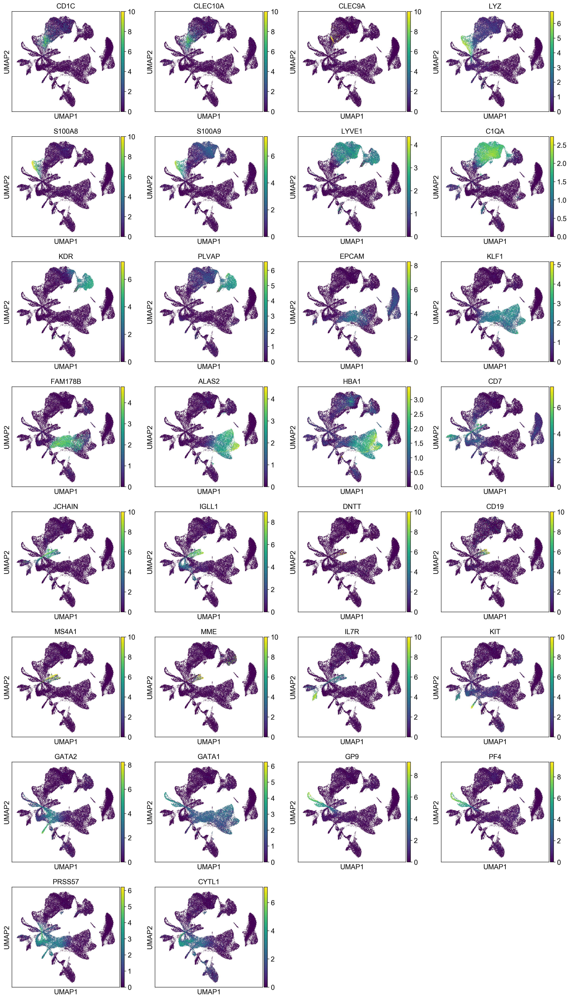

In [9]:
sc.pl.umap(adata, color=['CD1C',
'CLEC10A',
'CLEC9A',
'LYZ',
'S100A8',
'S100A9',
'LYVE1',
'C1QA',
'KDR',
'PLVAP',
'EPCAM',
'KLF1',
'FAM178B',
'ALAS2',
'HBA1',
'CD7',
'JCHAIN',
'IGLL1',
'DNTT',
'CD19',
'MS4A1',
'MME',
'IL7R',
'KIT',
'GATA2',
'GATA1',
'GP9',
'PF4',
'PRSS57',
'CYTL1'], use_raw=False)

In [10]:
adata.obs

,n_genes,n_counts,orig_ident,percent_mito,fetal_ids,sort_ids,tissue,lanes,stages,sample_type,gender,AnnatomicalPart,fullmeta,scrublet_score,scrublet_cluster_score,bh_pval,short_code,oldanno,subcluster_annotation,pred,annotated_clusters,annotated_clusters_reduced,cell.labels,leiden,__is_in_cluster__
index,,,,,,,,,,,,,,,,,,,,,,,,,
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGACCGGAT,4489,19142.0,F61,0.041741,F61,CD45+,Liver,FCAImmP7862084,F61,F61,NaN,F61_LI_CD45P_1,F61_Liver_CD45+_FCAImmP7862084,0.096525,0.065840,0.866956,FCAImmP7862084_AAACCTGAGACCGGAT,NA,"MEM_Progenitor,1",Early Erythroid,Early_Erythroid,Early_Erythroid,Early Erythroid,9,False
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGCTACCGC,1635,4586.0,F61,0.071304,F61,CD45+,Liver,FCAImmP7862084,F61,F61,NaN,F61_LI_CD45P_1,F61_Liver_CD45+_FCAImmP7862084,0.113490,0.099117,0.866956,FCAImmP7862084_AAACCTGAGCTACCGC,NA,"Myeloids,3",Kupffer Cell,Kupffer_Cell,Kupffer_Cell,Kupffer,7,False
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGTCCGGTC,2089,7673.0,F61,0.035579,F61,CD45+,Liver,FCAImmP7862084,F61,F61,NaN,F61_LI_CD45P_1,F61_Liver_CD45+_FCAImmP7862084,0.091589,0.059603,0.873299,FCAImmP7862084_AAACCTGAGTCCGGTC,NA,"Myeloids,7",Mono-Mac,Mono_Mac,Mono_Mac,Kupffer,2,False
F61_Liver_CD45+_FCAImmP7862084_AAACCTGAGTGTCCAT,2705,8042.0,F61,0.052226,F61,CD45+,Liver,FCAImmP7862084,F61,F61,NaN,F61_LI_CD45P_1,F61_Liver_CD45+_FCAImmP7862084,0.190698,0.138650,0.269950,FCAImmP7862084_AAACCTGAGTGTCCAT,NA,"Myeloids,1",Endothelial cell,Endothelial,Endothelial,Kupffer,19,False
F61_Liver_CD45+_FCAImmP7862084_AAACCTGCAAGTAATG,4796,36022.0,F61,0.116457,F61,CD45+,Liver,FCAImmP7862084,F61,F61,NaN,F61_LI_CD45P_1,F61_Liver_CD45+_FCAImmP7862084,0.156627,0.172552,0.043684,FCAImmP7862084_AAACCTGCAAGTAATG,NA,"Hepatoid,4",Hepatocyte,Hepatoid,Hepatoid,Hepatocyte,20,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
F32_Liver_CD45-_FCAImmP7316895_TTTGTCAAGGTGCACA,3207,13291.0,F32,0.014747,F32,CD45-,Liver,FCAImmP7316895,F32,F32,NaN,F32_LI_CD45N_Random,F32_Liver_CD45-_FCAImmP7316895,0.023729,0.043669,0.912260,FCAImmP7316895_TTTGTCAAGGTGCACA,Early Erythroid,"MEM_Progenitor,0",HSC_MPP,HSC_MPP,Early_Lymphoid,HSC/MPP,14,False
F32_Liver_CD45-_FCAImmP7316895_TTTGTCAAGTACGCCC,4192,38262.0,F32,0.142700,F32,CD45-,Liver,FCAImmP7316895,F32,F32,NaN,F32_LI_CD45N_Random,F32_Liver_CD45-_FCAImmP7316895,0.012436,0.013333,0.912260,FCAImmP7316895_TTTGTCAAGTACGCCC,Hepatocyte,"Hepatoid,0",Hepatocyte,Hepatoid,Hepatoid,Hepatocyte,32,False
F32_Liver_CD45-_FCAImmP7316895_TTTGTCACAAGCGATG,4917,32953.0,F32,0.035930,F32,CD45-,Liver,FCAImmP7316895,F32,F32,NaN,F32_LI_CD45N_Random,F32_Liver_CD45-_FCAImmP7316895,0.032988,0.037624,0.912260,FCAImmP7316895_TTTGTCACAAGCGATG,Early Erythroid,"MEM_Progenitor,0",HSC_MPP,HSC_MPP,Early_Lymphoid,HSC/MPP,14,False


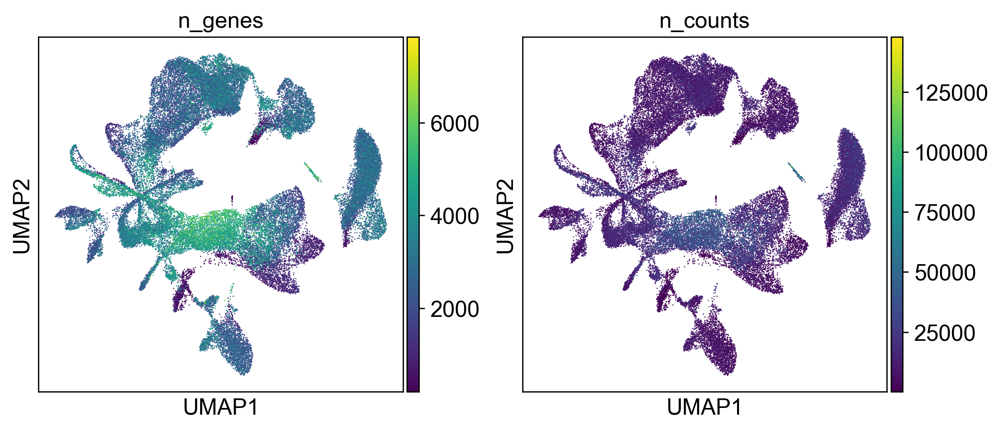

In [11]:
sc.pl.umap(adata, color=['n_genes', 'n_counts'])

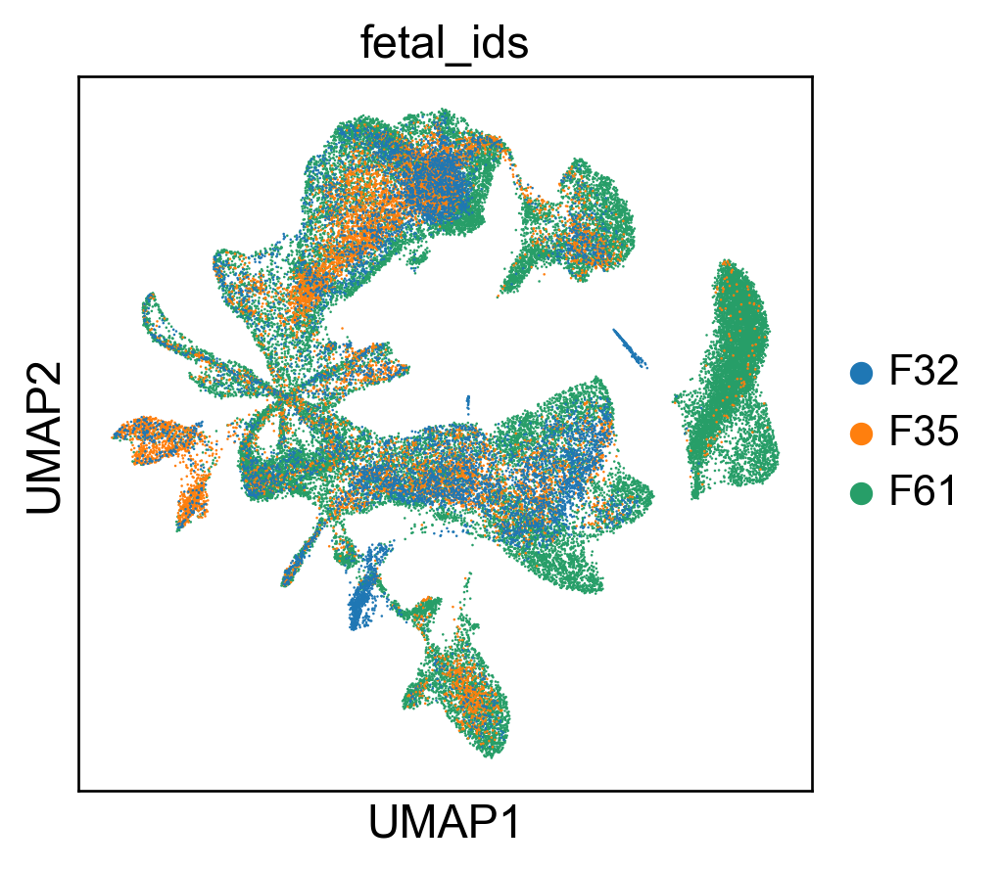

In [12]:
sc.pl.umap(adata, color=['fetal_ids'])

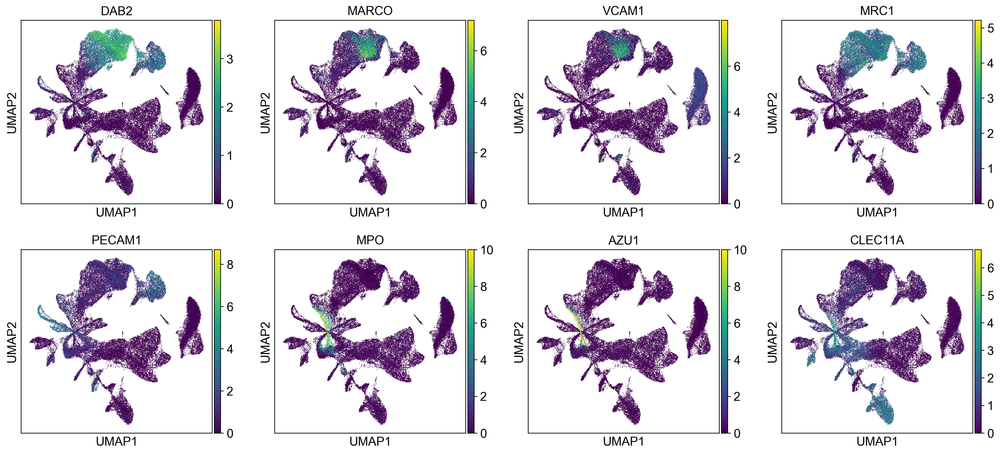

In [14]:
sc.pl.umap(adata, color=['DAB2',
'MARCO',
'VCAM1',
'MRC1',
'PECAM1',
'MPO',
'AZU1',
'CLEC11A'], use_raw=False)